# Housing Price Prediction

In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

#Ignoring Warnings
import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

In [2]:
#Importing Data using pandas
data = pd.read_csv('./housing.csv')
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


# Visualizing Data for better understanding

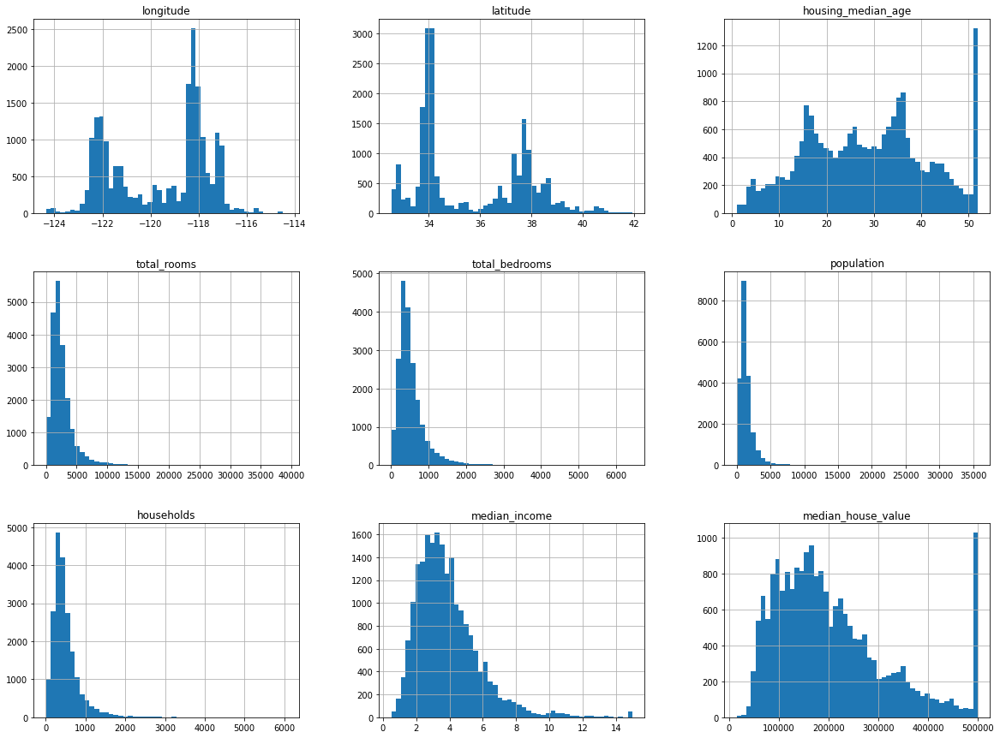

In [4]:
data.hist(bins=50, figsize=(20,15))
plt.show()

array([[<AxesSubplot:xlabel='median_house_value', ylabel='median_house_value'>,
        <AxesSubplot:xlabel='median_income', ylabel='median_house_value'>,
        <AxesSubplot:xlabel='total_rooms', ylabel='median_house_value'>,
        <AxesSubplot:xlabel='housing_median_age', ylabel='median_house_value'>],
       [<AxesSubplot:xlabel='median_house_value', ylabel='median_income'>,
        <AxesSubplot:xlabel='median_income', ylabel='median_income'>,
        <AxesSubplot:xlabel='total_rooms', ylabel='median_income'>,
        <AxesSubplot:xlabel='housing_median_age', ylabel='median_income'>],
       [<AxesSubplot:xlabel='median_house_value', ylabel='total_rooms'>,
        <AxesSubplot:xlabel='median_income', ylabel='total_rooms'>,
        <AxesSubplot:xlabel='total_rooms', ylabel='total_rooms'>,
        <AxesSubplot:xlabel='housing_median_age', ylabel='total_rooms'>],
       [<AxesSubplot:xlabel='median_house_value', ylabel='housing_median_age'>,
        <AxesSubplot:xlabel='median_incom

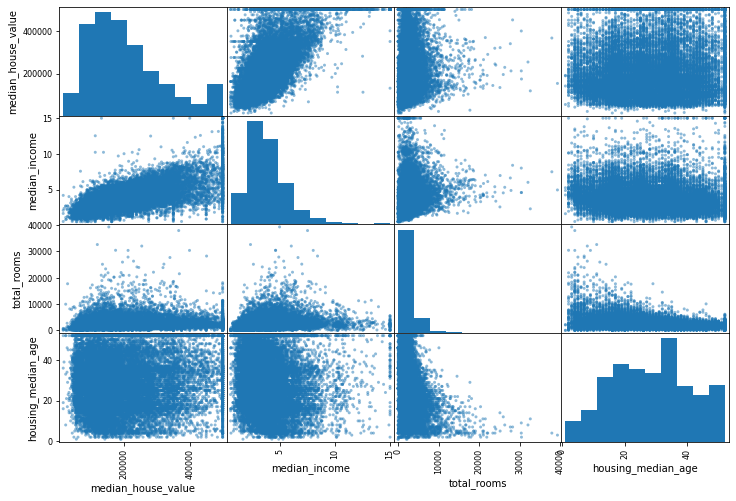

In [5]:
from pandas.plotting import scatter_matrix

attributes = ["median_house_value", "median_income", "total_rooms",
              "housing_median_age"]
scatter_matrix(data[attributes], figsize=(12, 8))

<AxesSubplot:xlabel='median_income', ylabel='median_house_value'>

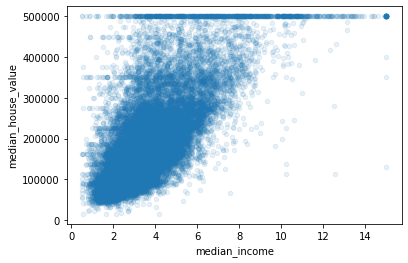

In [6]:
data.plot(kind="scatter", x="median_income", y="median_house_value",
             alpha=0.1)

# Preparing Data

In [7]:
#To-do
#- We need to remove the null values from total_bedrooms
#- Create some more attributes (3)
#- Check using correlation matrix the corelations
#- Convert ocean_proximity to numerical category

In [8]:
#Null-values in total_bedrooms
median = data['total_bedrooms'].median()
data['total_bedrooms'] = data['total_bedrooms'].fillna(median)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20640 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [9]:
corr = data.corr()
corr["median_house_value"].sort_values(ascending = False)

median_house_value    1.000000
median_income         0.688075
total_rooms           0.134153
housing_median_age    0.105623
households            0.065843
total_bedrooms        0.049457
population           -0.024650
longitude            -0.045967
latitude             -0.144160
Name: median_house_value, dtype: float64

In [10]:
#Creating some more attributes
from sklearn.base import BaseEstimator, TransformerMixin
class AttributeAdder(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X):
        return self
    def transform(self, X):
        X['rooms_per_household'] = X['total_rooms'] / X['households']
        X['bedrooms_per_room'] = X['total_bedrooms'] / X['total_rooms']
        X['population_per_household'] = X['population'] / X['households']
        return X

In [11]:
adr = AttributeAdder()
adr.fit_transform(data)
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,8.288136,0.129516,2.802260
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,5.817352,0.184458,2.547945
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,6.281853,0.172096,2.181467


In [12]:
corr = data.corr()
corr['median_house_value'].sort_values(ascending = False)

median_house_value          1.000000
median_income               0.688075
rooms_per_household         0.151948
total_rooms                 0.134153
housing_median_age          0.105623
households                  0.065843
total_bedrooms              0.049457
population_per_household   -0.023737
population                 -0.024650
longitude                  -0.045967
latitude                   -0.144160
bedrooms_per_room          -0.233303
Name: median_house_value, dtype: float64

In [13]:
#Converting ocean_proximity to numerical attribute
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
class CatAttr(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X):
        return self
    def transform(self, X):
        l_encode = LabelEncoder()
        o_encode = OneHotEncoder()
        X['ocean_proximity'] = l_encode.fit_transform(X['ocean_proximity'])
        X = o_encode.fit_transform(X)
        return X

In [14]:
catatr = CatAttr()
catatr.fit_transform(data)

<20640x89781 sparse matrix of type '<class 'numpy.float64'>'
	with 268320 stored elements in Compressed Sparse Row format>

In [15]:
data = pd.DataFrame(data)
data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,3,6.984127,0.146591,2.555556
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,3,6.238137,0.155797,2.109842
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,3,8.288136,0.129516,2.802260
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,3,5.817352,0.184458,2.547945
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,3,6.281853,0.172096,2.181467
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,1,5.045455,0.224625,2.560606
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,1,6.114035,0.215208,3.122807
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,1,5.205543,0.215173,2.325635
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,1,5.329513,0.219892,2.123209


# Preparing Data for Machine Learning Algorithm

In [16]:
X = data.drop(columns= ['median_house_value'])
y = data.median_house_value

In [17]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True)
print(f"{X_train.shape} + {X_test.shape}")

(16512, 12) + (4128, 12)


In [18]:
housing = data.copy() # Creating a copy so as not to lose the data while processing

In [19]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
housing = pd.DataFrame(scaler.fit_transform(housing))
housing

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,-1.327835,1.052548,0.982143,-0.804819,-0.972476,-0.974429,-0.977033,2.344766,2.129631,1.291089,0.628559,-1.029988,-0.049597
1,-1.322844,1.043185,-0.607019,2.045890,1.357143,0.861439,1.669961,2.332238,1.314156,1.291089,0.327041,-0.888897,-0.092512
2,-1.332827,1.038503,1.856182,-0.535746,-0.827024,-0.820777,-0.843637,1.782699,1.258693,1.291089,1.155620,-1.291686,-0.025843
3,-1.337818,1.038503,1.856182,-0.624215,-0.719723,-0.766028,-0.733781,0.932968,1.165100,1.291089,0.156966,-0.449613,-0.050329
4,-1.337818,1.038503,1.856182,-0.462404,-0.612423,-0.759847,-0.629157,-0.012881,1.172900,1.291089,0.344711,-0.639087,-0.085616
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,-0.758826,1.801647,-0.289187,-0.444985,-0.388283,-0.512592,-0.443449,-1.216128,-1.115804,-0.116739,-0.155023,0.165994,-0.049110
20636,-0.818722,1.806329,-0.845393,-0.888704,-0.922403,-0.944405,-1.008420,-0.691593,-1.124470,-0.116739,0.276881,0.021671,0.005021
20637,-0.823713,1.778237,-0.924851,-0.174995,-0.123608,-0.369537,-0.174042,-1.142593,-0.992746,-0.116739,-0.090318,0.021134,-0.071735
20638,-0.873626,1.778237,-0.845393,-0.355600,-0.304827,-0.604429,-0.393753,-1.054583,-1.058608,-0.116739,-0.040211,0.093467,-0.091225


# Machine Learning Models
# 1. Linear Regression

In [20]:
from sklearn.linear_model import LinearRegression
linear_regress = LinearRegression()
linear_regress.fit(X_train, y_train)

LinearRegression()

In [21]:
some_data = X.iloc[:5]
some_labels = y.iloc[:5] 
print(f"Predictions:    {linear_regress.predict(some_data)}")

Predictions:    [406760.79180391 433084.36051859 376669.92092577 318468.12819811
 248219.49822456]


In [22]:
some_labels

0    452600.0
1    358500.0
2    352100.0
3    341300.0
4    342200.0
Name: median_house_value, dtype: float64

In [23]:
from sklearn.metrics import mean_squared_error

linear_predict = linear_regress.predict(X_train)
linear_mse = mean_squared_error(y_train, linear_predict)
linear_rmse = np.sqrt(linear_mse)
print(f"Root Mean Squared Error is:     {linear_rmse}")

Root Mean Squared Error is:     68928.458909523


# 2. Decision Tree Regressor

In [24]:
from sklearn.tree import DecisionTreeClassifier
dec_tree = DecisionTreeClassifier()
dec_tree.fit(X_train, y_train)

DecisionTreeClassifier()

In [25]:

dtree_predict = dec_tree.predict(X_train)
dtree_mse = mean_squared_error(y_train, dtree_predict)
dtree_rmse = np.sqrt(dtree_mse)
print(f"Root Mean Squared Error is:     {dtree_rmse}")

Root Mean Squared Error is:     0.0


In [26]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(dec_tree, X_train, y_train,
                         scoring = "neg_mean_squared_error", cv = 10)
tree_scores = np.sqrt(-scores)

In [27]:
def display_scores(scores):
    print("scores:  ", scores)
    print("mean:  ", scores.mean())
    print("Standard Deviation:  ",scores.std())

In [28]:
#Prediction scores for Decision Tree Regressor
display_scores(tree_scores)

scores:   [81419.02116103 83217.3957956  80494.75107116 81248.57605972
 86945.47872054 83369.32778273 83786.20519315 85219.14029357
 84521.09222585 85163.05661162]
mean:   83538.4044914976
Standard Deviation:   1929.5119105317633


In [29]:
#Prediction scores for Linear Regression

linear_scores = cross_val_score(linear_regress, X_train, y_train,
                               scoring = 'neg_mean_squared_error', cv =10)
linear_scores = np.sqrt(-linear_scores)
display_scores(linear_scores)

scores:   [70751.49843208 69150.26934257 67705.07119355 67506.4112383
 70755.67396096 67987.93502258 70578.37758885 73858.8294014
 69041.21671581 66259.60847835]
mean:   69359.48913744437
Standard Deviation:   2083.8248795537206


# 3. Random Forest Regressor

In [30]:
from sklearn.ensemble import RandomForestRegressor
forest = RandomForestRegressor()
forest.fit(X_train, y_train)

RandomForestRegressor()

In [31]:
forest_predict = forest.predict(X_train)

forest_mse = cross_val_score(forest, X_train, y_train,
                            scoring = 'neg_mean_squared_error', cv = 10)
forest_scores = np.sqrt(-forest_mse)
display_scores(forest_scores)

scores:   [52296.22945088 50327.49931759 50426.37558837 48019.46993192
 50625.1889909  52420.69062323 51862.83946165 50754.35916738
 49500.27396436 51908.16277378]
mean:   50814.10892700757
Standard Deviation:   1305.2636438540842


In [32]:
print(f" Linear Regression:\t\t{linear_scores.mean()}\n Decision Tree Regressor:\t{tree_scores.mean()}\n Random Forest Regressor:\t{forest_scores.mean()}")

 Linear Regression:		69359.48913744437
 Decision Tree Regressor:	83538.4044914976
 Random Forest Regressor:	50814.10892700757


# Fine-Tune the model

In [33]:
from sklearn.model_selection import GridSearchCV

param_grid = [
    {'n_estimators' : [3, 10, 30], 'max_features' : [2, 4, 6, 8]},
    {'bootstrap' : [False], 'n_estimators' : [3, 10], 'max_features' : [2, 3, 4]}
]

forest_reg = RandomForestRegressor()

grid_search = GridSearchCV(forest_reg, param_grid, cv = 5,
                          scoring = 'neg_mean_squared_error')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             scoring='neg_mean_squared_error')

In [34]:
grid_search.best_params_

{'max_features': 4, 'n_estimators': 30}

In [35]:
curves = grid_search.cv_results_
for mean_score, params in zip(curves["mean_test_score"], curves["params"]):
    print(np.sqrt(-mean_score), params)

64184.959298670175 {'max_features': 2, 'n_estimators': 3}
55557.34614322827 {'max_features': 2, 'n_estimators': 10}
52130.447930789924 {'max_features': 2, 'n_estimators': 30}
59490.361500978295 {'max_features': 4, 'n_estimators': 3}
52230.12367307491 {'max_features': 4, 'n_estimators': 10}
50287.96050182243 {'max_features': 4, 'n_estimators': 30}
58910.51625554937 {'max_features': 6, 'n_estimators': 3}
52493.56461260433 {'max_features': 6, 'n_estimators': 10}
50733.66575092771 {'max_features': 6, 'n_estimators': 30}
60108.67597154522 {'max_features': 8, 'n_estimators': 3}
52861.70926093299 {'max_features': 8, 'n_estimators': 10}
51160.627073344964 {'max_features': 8, 'n_estimators': 30}
62338.376372005165 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
53578.55650257877 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
60128.58865059979 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
51621.27930058922 {'bootstrap': False, 'max_features': 3, 'n_estimators

# Creating the final model, with the best parameters!

In [36]:
final_model = grid_search.best_estimator_

final_predictions = final_model.predict(X_test)
final_mse = mean_squared_error(y_test, final_predictions)
final_rmse = np.sqrt(final_mse)
print(final_rmse)

49212.80386789834


# Saving the model

In [37]:
import joblib
joblib.dump(final_model, "my_model.pkl")

['my_model.pkl']